In [1]:
import os
import sys
from multiprocessing import Pool
import PIL
import PIL.Image as Image
from tqdm import tqdm
import numpy as np

In [3]:
#Need  to have pytorch for image grid
#!conda install pytorch torchvision cpuonly -c pytorch --yes
import torch
from torchvision.utils import make_grid
from torchvision.transforms.functional import to_pil_image

In [ ]:
#!pip install torch
#!pip install torchvision

## Resize, crop, and create folder

In [2]:
def load_image(filename):
    return Image.open(filename).convert('RGB') #this conversion is crucial as PIL will open png files with either 3 or 4 channels depending on encoding

def center_crop(img):
    '''Algorithm derived from nvidia preprocessor'''
    crop = np.min(img.shape[:2])
    img = img[(img.shape[0]-crop)//2:(img.shape[0]+crop)//2,(img.shape[1]-crop)//2:(img.shape[1]+crop)//2]
    img = Image.fromarray(img,'RGB')
    return img

def resize_and_crop(fp,width,height):
    img=np.asarray(load_image(fp),dtype=np.uint8)
    img=center_crop(img)
    
#     if img.size[1]<height or img.size[0]<width:
#         print('here')
#         print(fp)
    
    img=img.resize((width,height),Image.LANCZOS)
    img=np.array(img)
    
    canvas = np.zeros([width,width,3],dtype=np.uint8)
    canvas[(width-height)//2: (width+height)//2,:]=img
    return canvas 
def save_image(filename,subfolder,img):
    if not os.path.exists(os.path.join('Cropped Images',subfolder)):
        os.mkdir(os.path.join('Cropped Images',subfolder))
    if not os.path.exists(f'{os.path.join("Cropped Images",subfolder,filename)}.jpg'):
        img.save(f'{os.path.join("Cropped Images",subfolder,filename)}.jpg')

def get_files_with_image_endings(fp):
    img_endings = ['.png','.jpg','.jpeg']
    files = [i for i in os.listdir(fp) if any([i.endswith(ending) for ending in img_endings])]
    return files

def crop_folder(folder,width = 256, height = 256):
    base_fp= os.path.join('Images',folder)

    if not os.path.exists('Cropped Images'):
        os.mkdir('Cropped Images')
    files = get_files_with_image_endings(base_fp)
    post_fix = {'Success':0,'Failed':0}
    pbar = tqdm(files)
    for file in pbar:
        fp = os.path.join(base_fp,file)
        if os.path.exists(os.path.join('Cropped Images',folder,file)):
            continue
        try: #catches incorrectly sized or downloaded images
            img=Image.fromarray(resize_and_crop(fp,width,height),'RGB')
            if img.size[0]<height or img.size[1]<width:
                post_fix['Failed']+=1 
                
            filename = fp.split('/')[-1].split('.')[0]
            save_image(filename,folder,img)
            post_fix['Success']+=1  
        except ValueError:
            post_fix['Failed']+=1 
        except:
            post_fix['Failed']+=1 
        
        pbar.set_postfix(post_fix)
    pbar.close()
  

def q(x):
    file,base_fp,height,width,folder = x
    fp = os.path.join(base_fp,file)
    if os.path.exists(fp):
        return
    try: #catches incorrectly sized or downloaded images
        img=Image.fromarray(resize_and_crop(fp,width,height),'RGB')
        filename = fp.split('/')[-1].split('.')[0]
        save_image(filename,folder,img)
    except:
        return
    
def crop_folder_multi(folder,width=256,height=256):
    base_fp= os.path.join('Images',folder)
    
    if not os.path.exists('Cropped Images'):
        os.mkdir('Cropped Images')
    files = get_files_with_image_endings(base_fp)
    post_fix = {'Success':0,'Failed':0}
    files = [[ file,base_fp,height,width,folder] for file in files]
    pool=Pool(4)
    
    for _ in tqdm(pool.imap_unordered(q,files),total=len(files)):
        pass
    pool.close()
    pool.join()
                  


In [4]:
folder ='Idiotswithguns'
crop_folder(folder)

  0%|          | 0/1505 [00:00<?, ?it/s]

In [7]:
folder ='ChicksWithGuns'
crop_folder(folder)

  0%|          | 0/2827 [00:00<?, ?it/s]

In [8]:
folder ='TheWayWeWere'
crop_folder(folder)

  0%|          | 0/5939 [00:00<?, ?it/s]

/Users/mashyman/opt/anaconda3/lib/python3.9/site-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (120384000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
/Users/mashyman/opt/anaconda3/lib/python3.9/site-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (98683655 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
/Users/mashyman/opt/anaconda3/lib/python3.9/site-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (120714790 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
/Users/mashyman/opt/anaconda3/lib/python3.9/site-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (107331840 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [9]:
folder ='portraits'
crop_folder(folder)

  0%|          | 0/3490 [00:00<?, ?it/s]

/Users/mashyman/opt/anaconda3/lib/python3.9/site-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (97141275 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [19]:
folder = 'Weapons'
crop_folder(folder)

  0%|                                                  | 0/3000 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_18222/2385116033.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 3000/3000 [00:37<00:00, 80.54it/s, Success=3000, Failed=0]


In [3]:
folder = 'guns'
crop_folder(folder)


  0%|                                                  | 0/8579 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
 60%|█████████▌      | 5127/8579 [01:07<09:48,  5.87it/s, Success=430, Failed=3]/opt/homebrew/Caskroom/miniforge/base/envs/tensorflow/lib/python3.9/site-packages/PIL/Image.py:3011: DecompressionBombWarning: Image size (108000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
 68%|██████████▏    | 5843/8579 [03:08<13:19,  3.42it/s, Success=1148, Failed=3]/opt/homebrew/Caskroom/miniforge/base/envs/tensorflow/lib/python3.9/site-packages/PIL/Image.py:992: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
100%|███████████████| 8579/8579 [10:26<00:00

In [4]:
folder = 'Military'
crop_folder(folder)

  0%|                                                  | 0/3953 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 3953/3953 [04:01<00:00, 16.38it/s, Success=3953, Failed=0]


In [5]:
folder = 'pics'
crop_folder(folder)

  0%|                                                  | 0/4579 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 4579/4579 [10:24<00:00,  7.33it/s, Success=4576, Failed=2]


In [6]:
folder = 'Shooting'
crop_folder(folder)

  0%|                                                   | 0/278 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|██████████████████| 278/278 [00:34<00:00,  8.04it/s, Success=278, Failed=0]


In [7]:
folder = 'Guns_Guns_Guns'
crop_folder(folder)

  0%|                                                  | 0/1433 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 1433/1433 [02:06<00:00, 11.29it/s, Success=1433, Failed=0]


In [8]:
folder = 'airsoft'
crop_folder(folder)

  0%|                                                  | 0/2011 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 2011/2011 [04:02<00:00,  8.30it/s, Success=2010, Failed=1]


In [9]:
folder = 'Shotguns'
crop_folder(folder)

  0%|                                                  | 0/2632 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|███████████████| 2632/2632 [06:29<00:00,  6.75it/s, Success=2631, Failed=1]


In [15]:
folder = 'oos_weapon'
crop_folder(folder)

  0%|                                                   | 0/162 [00:00<?, ?it/s]/var/folders/zx/_x1xg_4n2hj8d_6dx7nmrm5m0000gn/T/ipykernel_25420/2454103577.py:19: DeprecationWarning: LANCZOS is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.LANCZOS instead.
  img=img.resize((width,height),Image.LANCZOS)
100%|██████████████████| 162/162 [00:34<00:00,  4.76it/s, Success=162, Failed=0]


In [ ]:
##Data Collection and exploration folder
###Readme.txt explaining how the various stages were run in order

##Composited training list (post clip)
##Download data function [accounting for potential image deletions]
##Final CNN training notebook
##CNN usage notebook
#Adversarial and out of sample cropped images
##Final model example notebook
##Final Model weights folder


From manual inspection quite a few images in these photo libraries do not contain a person holding a gun. This will be resolved using CLIP to remove photos that are not deemed likely to have a human.

In [10]:
def load_image_numpy(filename):
    return np.asarray(load_image(filename))


def show_folder_grid(fp,nrows=8,seed=21):
    np.random.seed(seed)
    files=get_files_with_image_endings(fp)
    files=np.random.choice(files,nrows**2)

    imgs = torch.from_numpy(np.array([load_image_numpy(os.path.join(fp,file)) for file in files]))
    imgs = imgs.permute((0,3,1,2)) #reorder from bhwc to bchw
    return to_pil_image(make_grid(imgs,nrow=nrows)),files

    

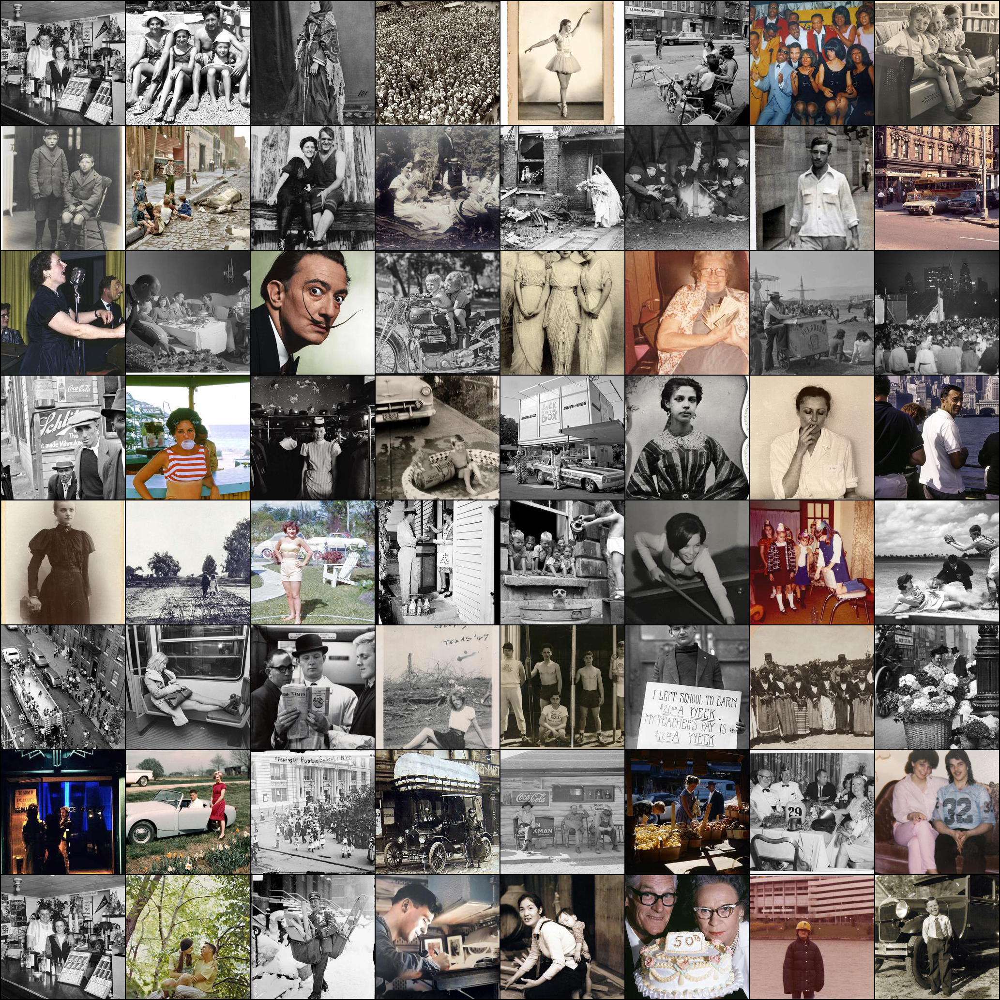

In [11]:
grid, files = show_folder_grid('Cropped Images/TheWayWeWere',seed=11)
grid

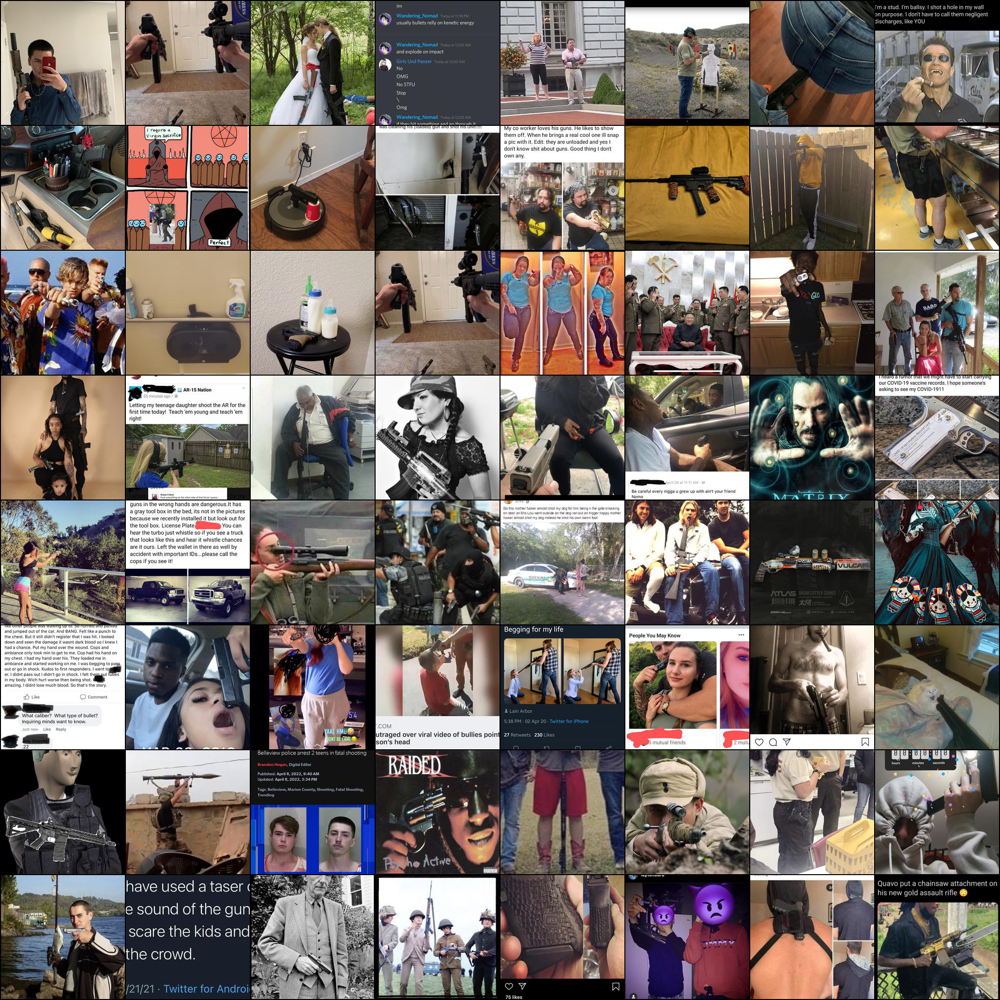

In [13]:
grid, files = show_folder_grid('Cropped Images/Idiotswithguns',seed=11)
grid

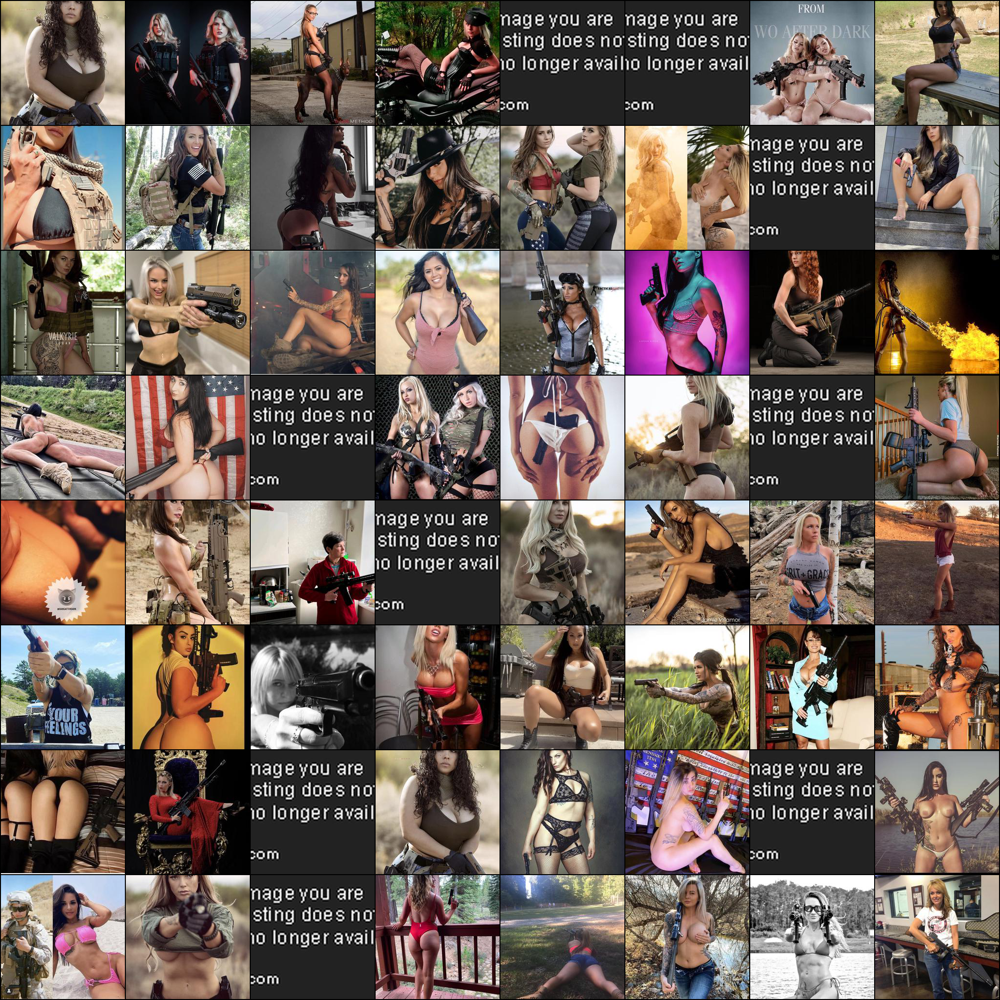

In [14]:
grid, files = show_folder_grid('Cropped Images/ChicksWithGuns',seed=11)
grid

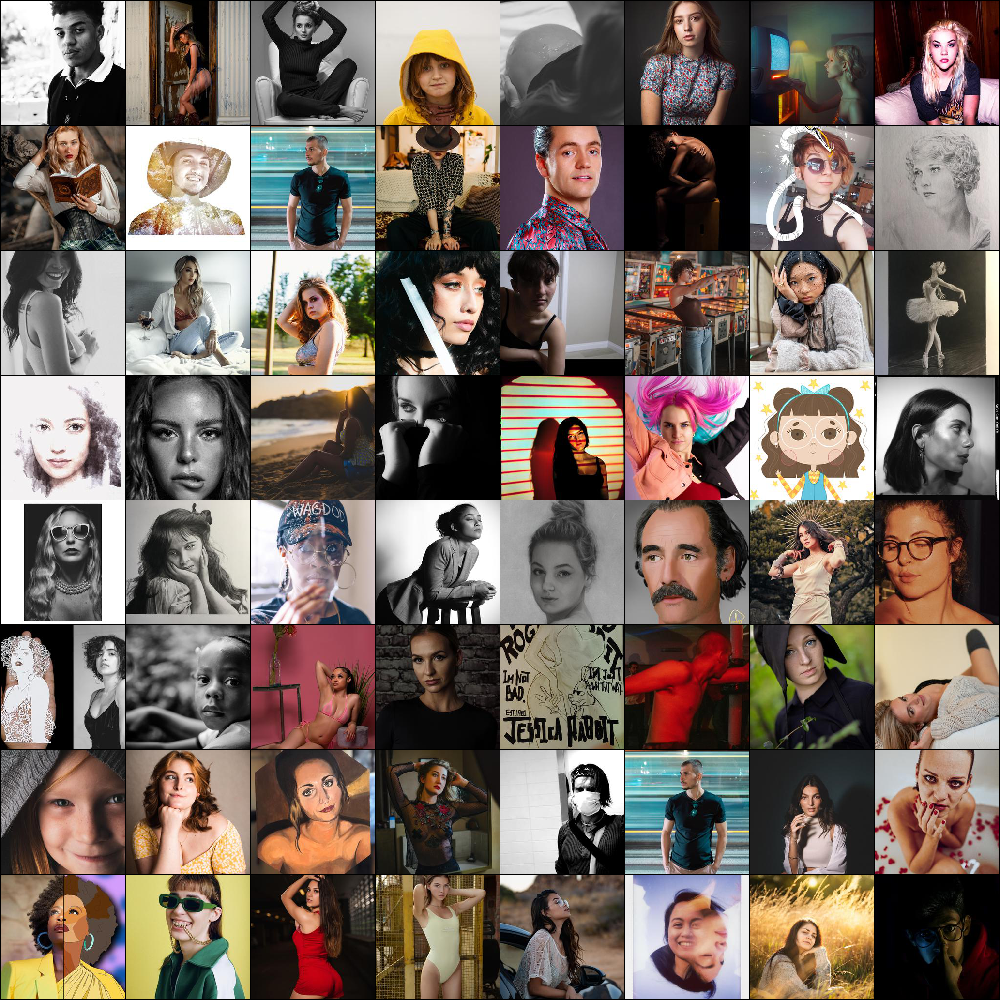

In [15]:
grid, files = show_folder_grid('Cropped Images/portraits',seed=11)
grid

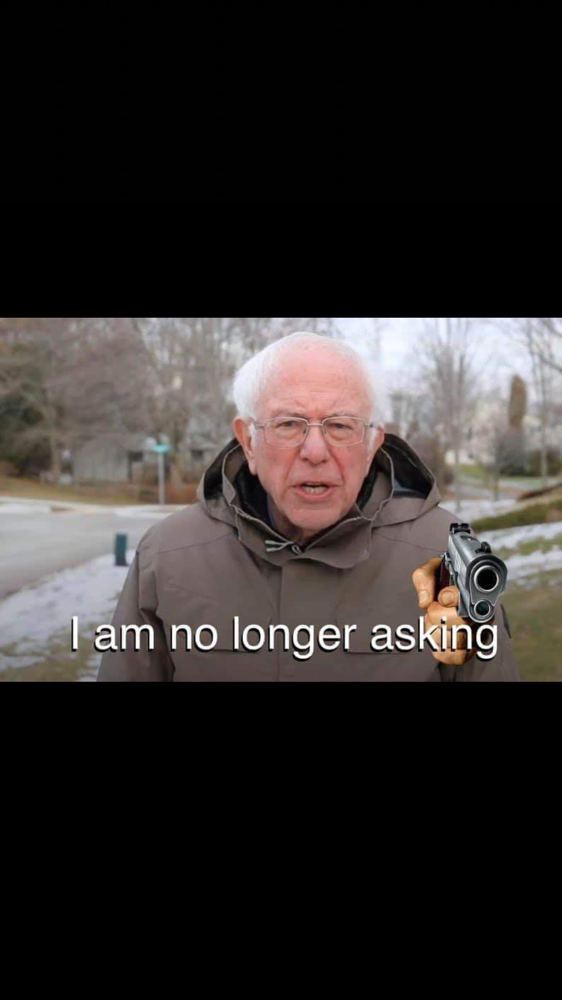

In [12]:
load_image('Images/Idiotswithguns/pgvwccN.png')#.size

In [16]:
load_image('Images/Idiotswithguns/jlnbin1e0jx61.png').size

(720, 602)

In [17]:
check = 'zmenb3e7dco31.png'
print(load_image(f'Images/Idiotswithguns/{check}').size)

#load_image(f'Cropped Images/Idiotswithguns/{check}')
# check = '5rbhzmly8ye71.png'
# print(load_image(f'Images/Idiotswithguns/{check}').size)

# check='6glg2dpyep771.jpg'
# here
# Images/Idiotswithguns/d8gyfvh4rgy51.jpg
# here
# Images/Idiotswithguns/4fgvjys9q0721.jpg
# here
# Images/Idiotswithguns/34rcwelm32k61.png
# here
# Images/Idiotswithguns/2J8XzVc.png
# here
# Images/Idiotswithguns/v1v2ybgtx6r51.jpg
# here
# Images/Idiotswithguns/2oupdx90hy241.png
# here
# Images/Idiotswithguns/hb4ot7k7c9u51.jpg
# here
# Images/Idiotswithguns/2s3q3y4r4a671.jpg
# here
# Images/Idiotswithguns/qhymu6otd0w41.png
# here
# Images/Idiotswithguns/t6az0KU.jpg
# here
# Images/Idiotswithguns/QJqMF7t.jpg

(700, 479)
